# Conditional DCGANs

## Initialization

In [1]:
# Install required libraries
!pip install -q torch_snippets torch_summary

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.8/30.8 MB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.4/177.4 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 21.0 MB/s eta 0:00:

In [2]:
# Import libraries
import numpy as np
import pandas as pd

import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary
from torch_snippets import *

import cv2
from PIL import Image

print(f"PyTorch Version: {torch.__version__}")
!nvidia-smi # check if GPU is available
%matplotlib inline

PyTorch Version: 2.2.1+cu121

Thu Apr  4 21:45:37 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8              12W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", device)

Running on: cuda

In [4]:
# Download and extract the dataset
!wget https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
!unzip -q male_female_face_images.zip

--2024-04-04 21:45:38--  https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.81.18, 2620:100:6031:18::a27d:5112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.81.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/rbajpdlh7efkdo1/male_female_face_images.zip [following]
--2024-04-04 21:45:38--  https://www.dropbox.com/s/raw/rbajpdlh7efkdo1/male_female_face_images.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucedf7d8498c868443e4ea9f5005.dl.dropboxusercontent.com/cd/0/inline/CQaIysE-KLVGBIG4UHIHxvW0z6DW5lnRcANgelxeaNvBVBmcw0g7EphJVPKA5clHqv_V4L02W-je7Z_VUxpgOtRhhzoOSNHS8LzhNFB674kTaCQj_XhIJcWkO1BQHYy-3TDMcKf-MVLkDUsb5oef-qlX/file# [following]
--2024-04-04 21:45:38--  https://ucedf7d8498c868443e4ea9f5005.dl.dropboxusercontent.com/cd/0/inline/CQaIysE-KLVGBIG4UHIHxvW0z6DW5lnRcANgelxeaNvBVBmcw0g7Ep

In [5]:
# Initialize the face detector from OpenCV
face_cascade = cv2.CascadeClassifier(f'{cv2.data.haarcascades}haarcascade_frontalface_default.xml')

# Create a directory and store the female cropped faces
!mkdir cropped_faces_female
female_images = Glob('/content/females/*.jpg')
for i in range(len(female_images)):
    image = read(female_images[i], 1)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray_image, 1.3, 5)
    for (x, y, w, h) in faces:
        cropped_image = image[y:(y+h), x:(x+w), :]
    cv2.imwrite(f'cropped_faces_female/{str(i)}.jpg', cv2.cvtColor(cropped_image, cv2.COLOR_RGB2BGR))

# Create a directory and store the male cropped faces
!mkdir cropped_faces_male
male_images = Glob('/content/males/*.jpg')
for i in range(len(male_images)):
    image = read(male_images[i], 1)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray_image, 1.3, 5)
    for (x, y, w, h) in faces:
        cropped_image = image[y:(y+h), x:(x+w), :]
    cv2.imwrite(f'cropped_faces_male/{str(i)}.jpg', cv2.cvtColor(cropped_image, cv2.COLOR_RGB2BGR))

In [6]:
# Set up a transform pipeline for the images (resize, center crop, to tensor, normalize)
transform = transforms.Compose(
    [
        transforms.Resize(64),
        transforms.CenterCrop(64),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

In [7]:
# Create Dataset class to fetch images and labels
class Faces(Dataset):
    def __init__(self, folders):
        super().__init__()
        self.female_folder = folders[0]
        self.male_folder = folders[1]
        self.images = sorted(Glob(self.female_folder)) + sorted(Glob(self.male_folder))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = self.images[idx]
        image = Image.open(image_path)
        image = transform(image)
        gender = np.where('female' in str(image_path), 1, 0) # 1 Female, 0 Male
        return image, torch.tensor(gender).long()

In [8]:
# Create the train dataset
train_ds = Faces(folders=['cropped_faces_female','cropped_faces_male'])

# Create a function to retrieve the dataloaders
def load_data(batch_size = 64):
    return DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=8)

In [9]:
# Create a function to initialize weights so they have less spread
def weights_init(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

In [10]:
class Discriminator(nn.Module):
    def __init__(self, embeddings_size=32):
        super(Discriminator, self).__init__()
        self.label_embeddings = nn.Embedding(2, embeddings_size)
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 64*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64*2, 64*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64*4, 64*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64*8, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten()
        )
        self.classifier = nn.Sequential(
            nn.Linear(288, 100), # 288 (input) = 256 (features) + 32 (embeddings)
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(100, 1),
            nn.Sigmoid()
        )
        self.apply(weights_init)

    def forward(self, x, y): # x: images, y: labels
        x = self.features(x)
        y = self.label_embeddings(y)
        feats_embs = torch.cat([x, y], 1)
        return self.classifier(feats_embs) # Return the probability of the image being real

In [11]:
# Create a mock-up Discriminator model and print summary
discriminator = Discriminator().to(device)
summary(discriminator, torch.zeros(32, 3, 64, 64).to(device), torch.zeros(32).long().to(device))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11                   [-1, 512, 4, 4]           --
|    └─Conv2d: 2-12                      [-1, 64, 2, 2]     

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11                   [-1, 512, 4, 4]           --
|    └─Conv2d: 2-12                      [-1, 64, 2, 2]     

In [12]:
class Generator(nn.Module):
    def __init__(self, embeddings_size=32):
        super().__init__()
        self.embeddings_size = embeddings_size
        self.label_embeddings = nn.Embedding(2, self.embeddings_size)
        self.upsampler = nn.Sequential(
            nn.ConvTranspose2d(100+self.embeddings_size, 64*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64*8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*8, 64*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*4, 64*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)

    def forward(self, x_noise, y): # x: images noise, y: labels
        label_embeddings = self.label_embeddings(y).view(len(y), self.embeddings_size, 1, 1)
        noise_embs = torch.cat([x_noise, label_embeddings], 1)
        return self.upsampler(noise_embs) # Return the generated image

In [13]:
# Create a mock-up Generator model and print summary
generator = Generator().to(device)
summary(generator, torch.zeros(32, 100, 1, 1).to(device), torch.zeros(32).long().to(device))

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

In [14]:
# Create a function to generate random noise
def noise(size):
    return torch.randn(size, 100, 1, 1, device=device)

In [15]:
# Create a function to train the Discriminator
def train_discriminator(model, data, criterion, optimizer):
    model.train()
    optimizer.zero_grad()
    real_data, real_labels, fake_data, fake_labels = data
    prediction_real = model(real_data, real_labels)
    error_real = criterion(prediction_real, torch.ones(len(real_data), 1).to(device))
    error_real.backward()
    prediction_fake = model(fake_data, fake_labels)
    error_fake = criterion(prediction_fake, torch.zeros(len(fake_data), 1).to(device))
    error_fake.backward()
    optimizer.step()
    return error_real + error_fake

# Create a function to train the Generator
def train_generator(model, data, criterion, optimizer):
    model.train()
    optimizer.zero_grad()
    fake_data, fake_labels = data
    prediction = model(fake_data, fake_labels) # Discriminator prediction
    error = criterion(prediction, torch.ones(len(fake_data), 1).to(device))
    error.backward()
    optimizer.step()
    return error

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


EPOCH: 1.000  g_loss: 3.329  d_loss: 0.517  (62.65s - 1503.65s remaining)


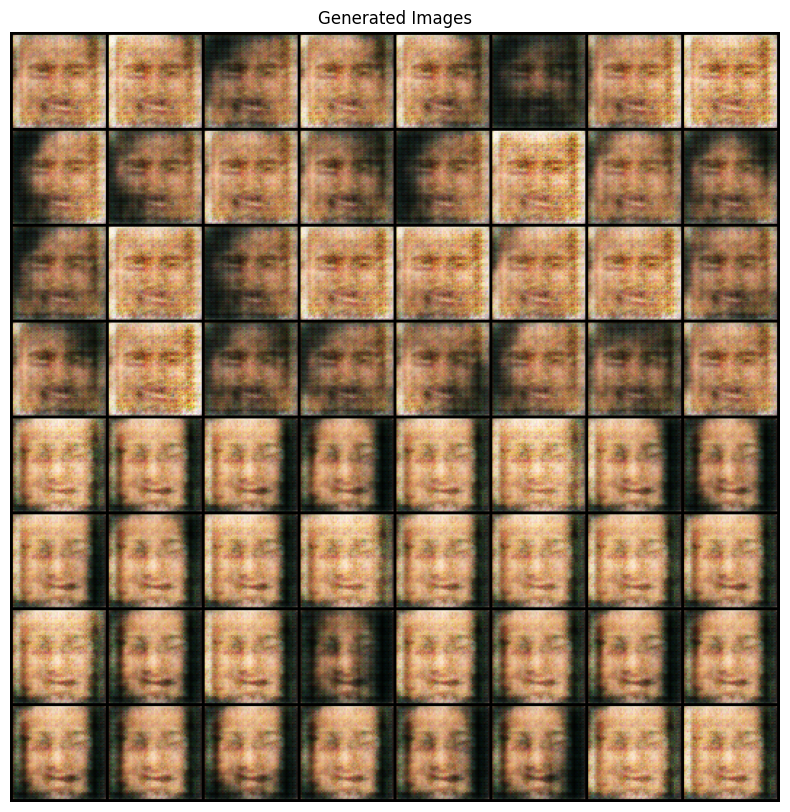

EPOCH: 2.000  g_loss: 4.817  d_loss: 0.475  (128.08s - 1472.97s remaining)


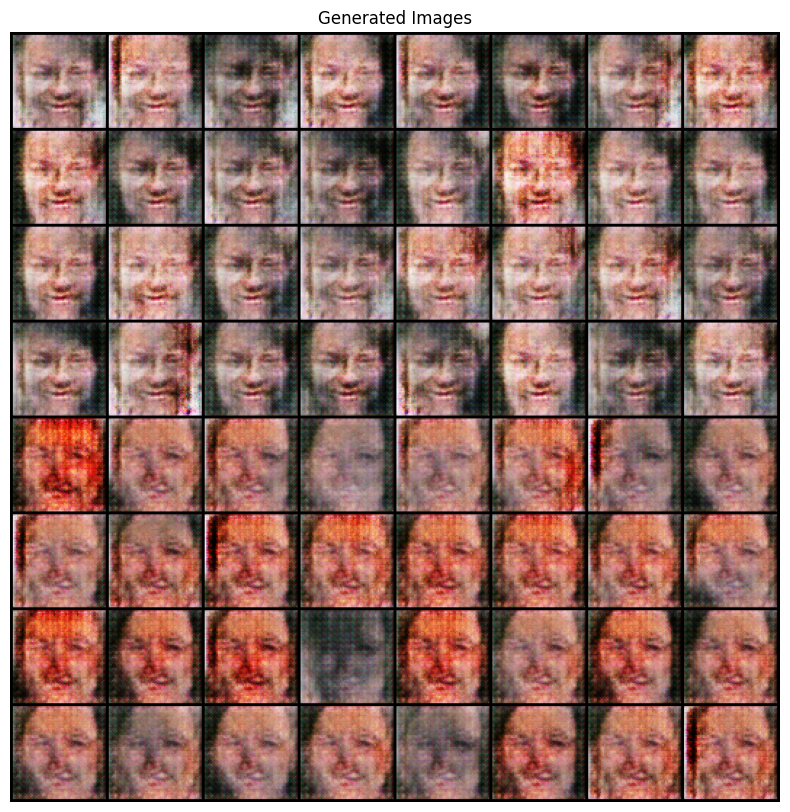

EPOCH: 3.000  g_loss: 5.714  d_loss: 0.410  (198.40s - 1454.96s remaining)


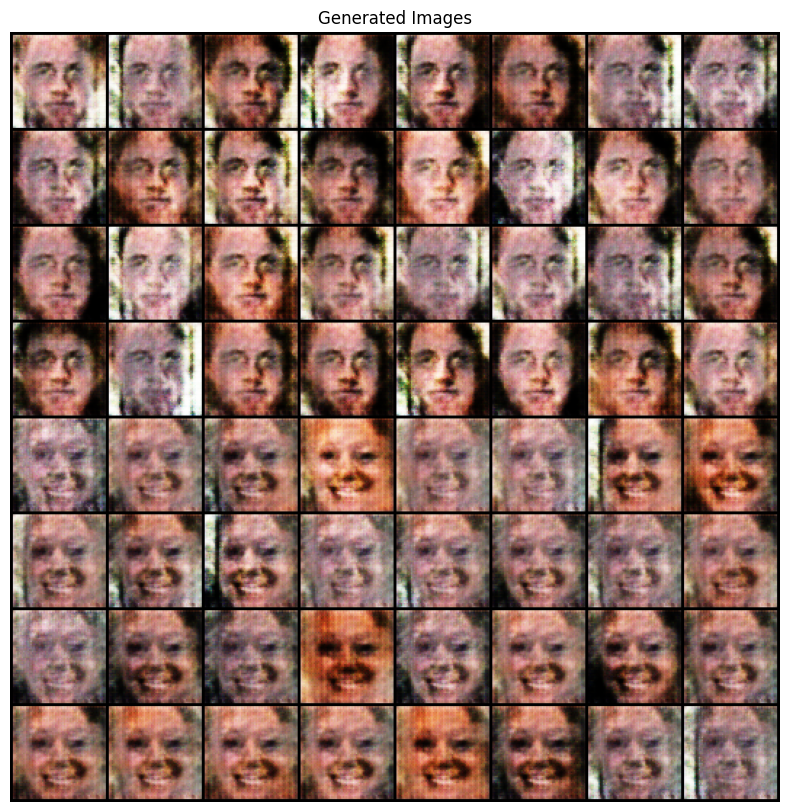

EPOCH: 4.000  g_loss: 6.111  d_loss: 0.412  (266.44s - 1398.80s remaining)


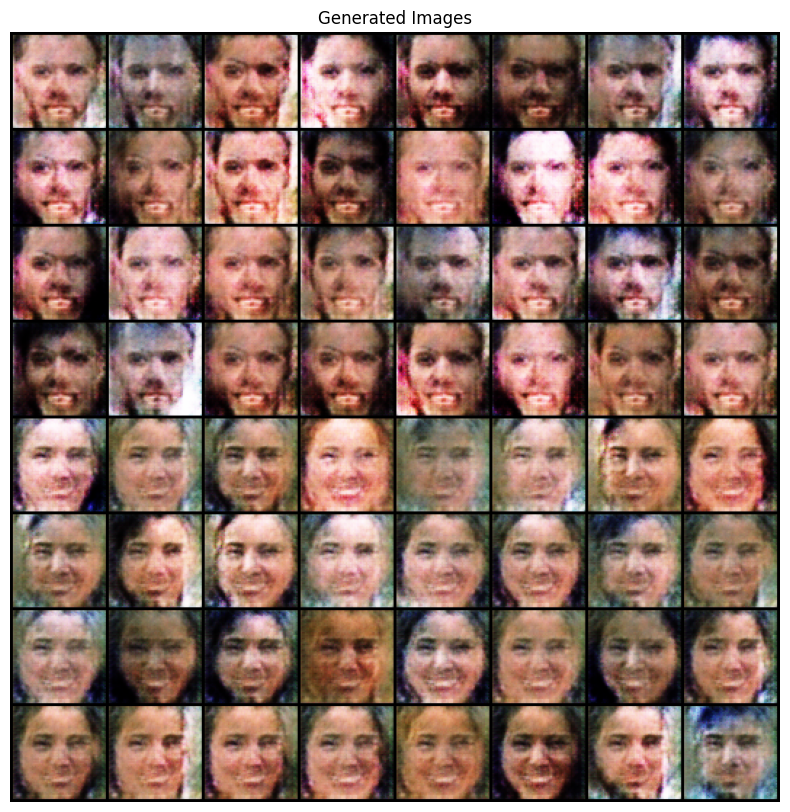

EPOCH: 5.000  g_loss: 6.142  d_loss: 0.415  (333.76s - 1335.02s remaining)


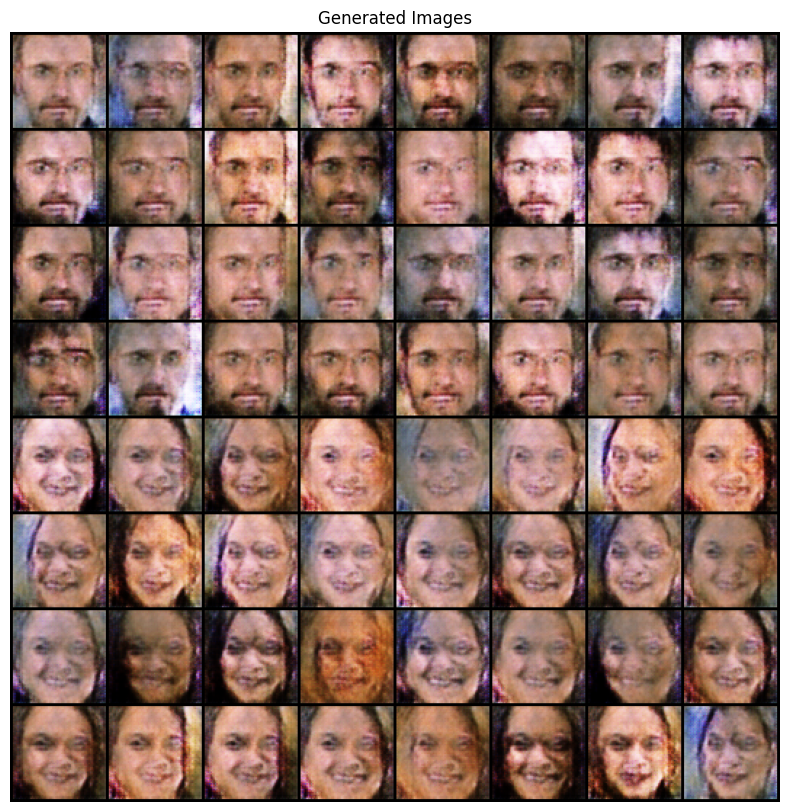

EPOCH: 6.000  g_loss: 6.286  d_loss: 0.438  (401.01s - 1269.86s remaining)


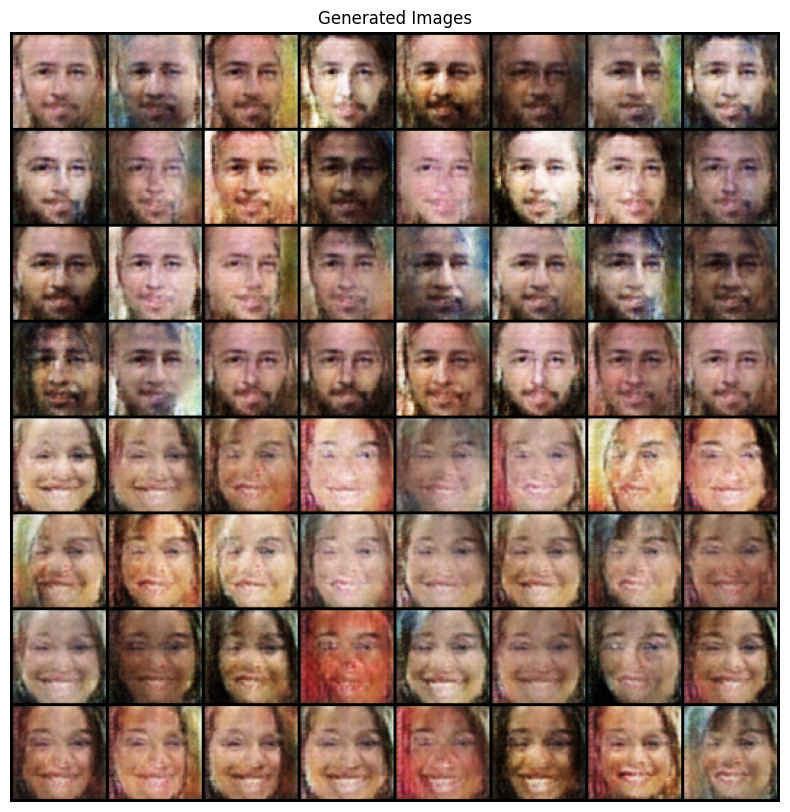

EPOCH: 7.000  g_loss: 5.773  d_loss: 0.454  (467.98s - 1203.37s remaining)


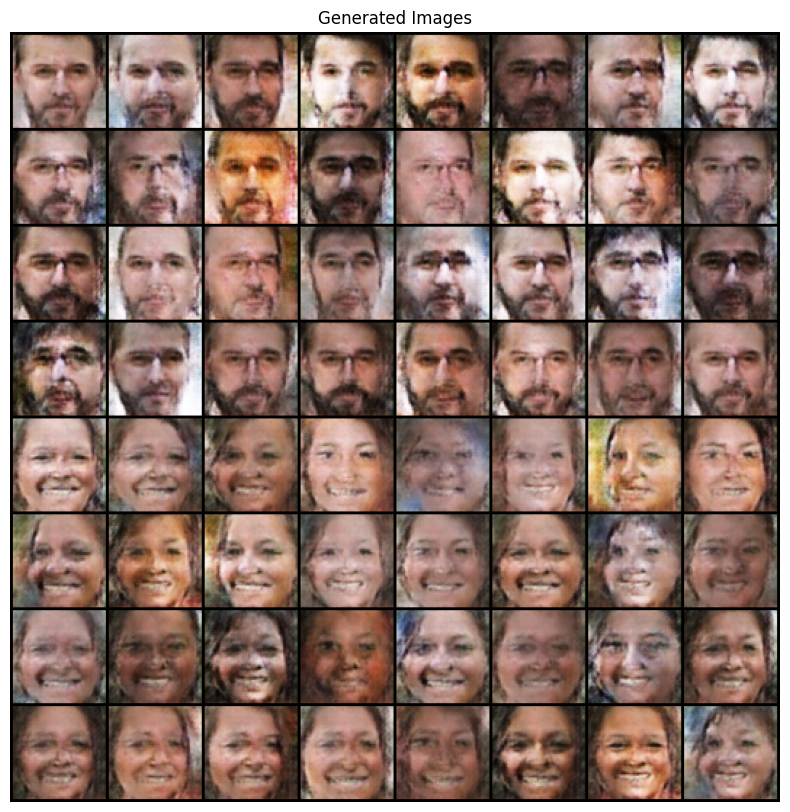

EPOCH: 8.000  g_loss: 5.380  d_loss: 0.421  (536.52s - 1140.11s remaining)


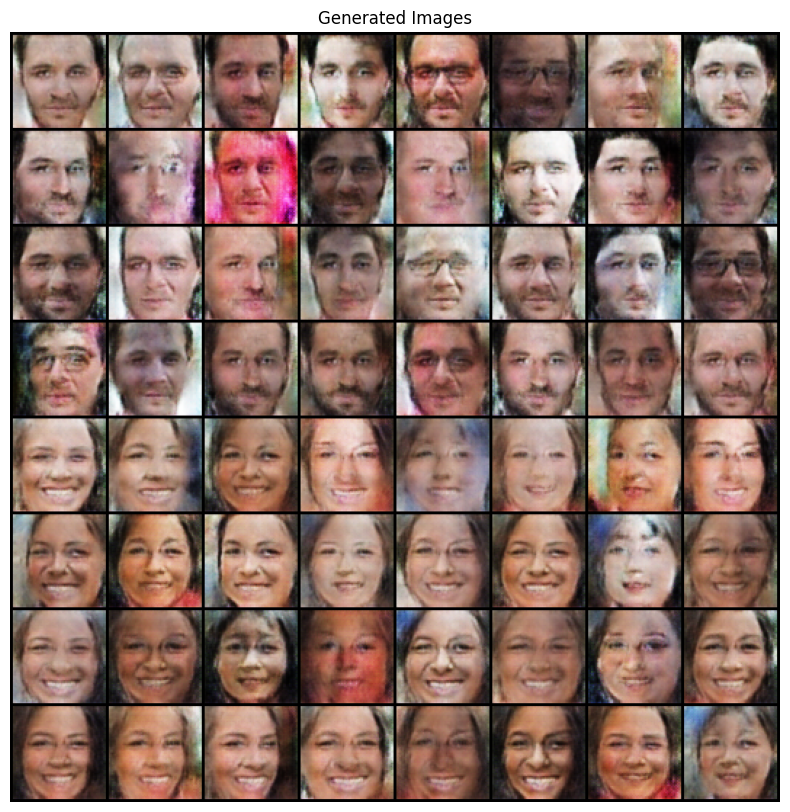

EPOCH: 9.000  g_loss: 5.235  d_loss: 0.466  (605.66s - 1076.72s remaining)


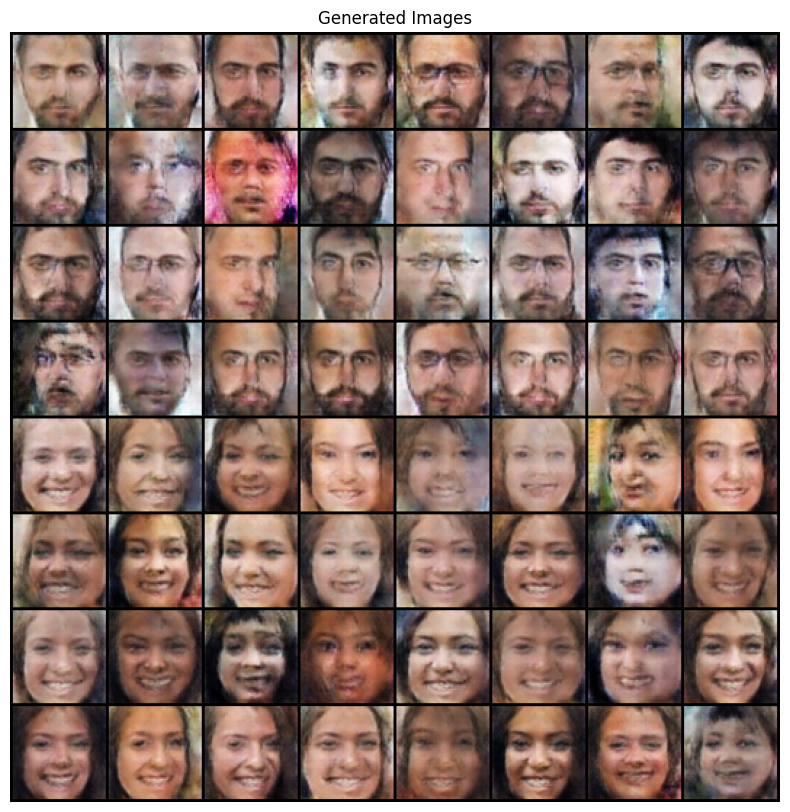

EPOCH: 10.000  g_loss: 4.910  d_loss: 0.458  (677.04s - 1015.57s remaining)


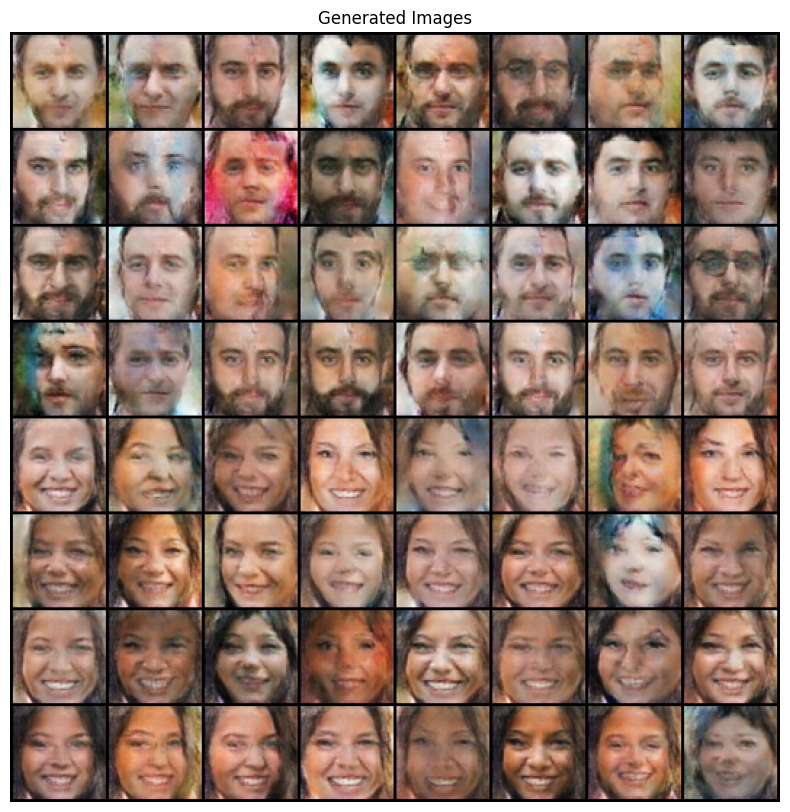

EPOCH: 11.000  g_loss: 4.814  d_loss: 0.482  (746.85s - 950.54s remaining)


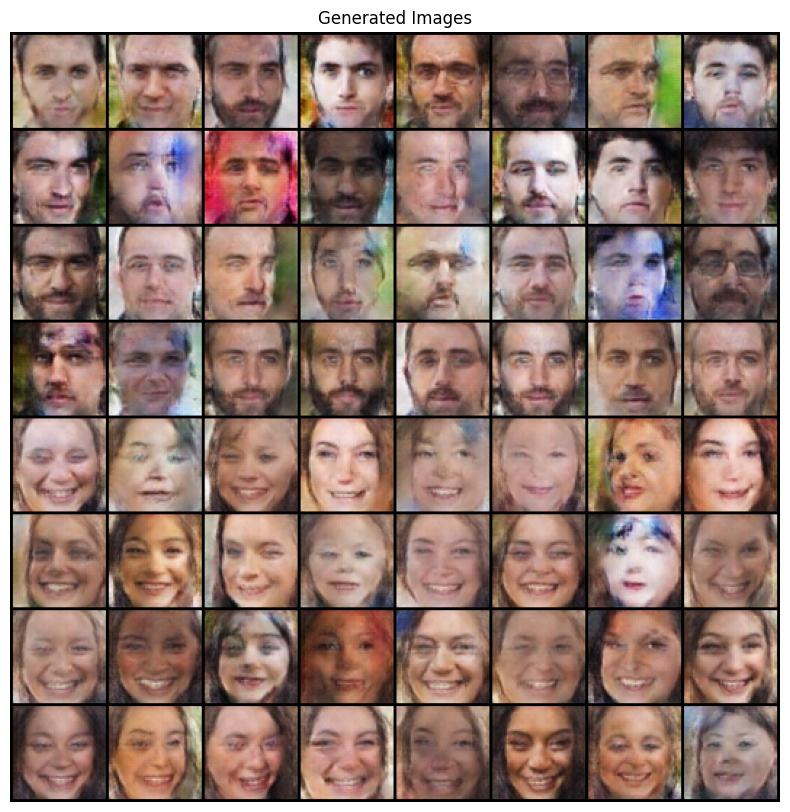

EPOCH: 12.000  g_loss: 4.818  d_loss: 0.459  (818.55s - 886.76s remaining)


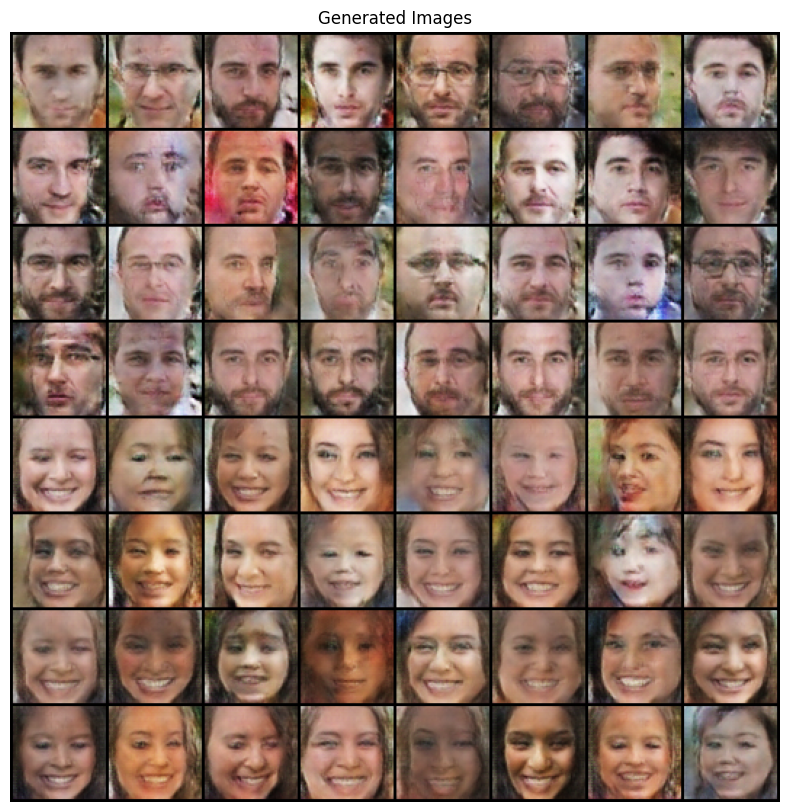

EPOCH: 13.000  g_loss: 4.740  d_loss: 0.468  (888.99s - 820.61s remaining)


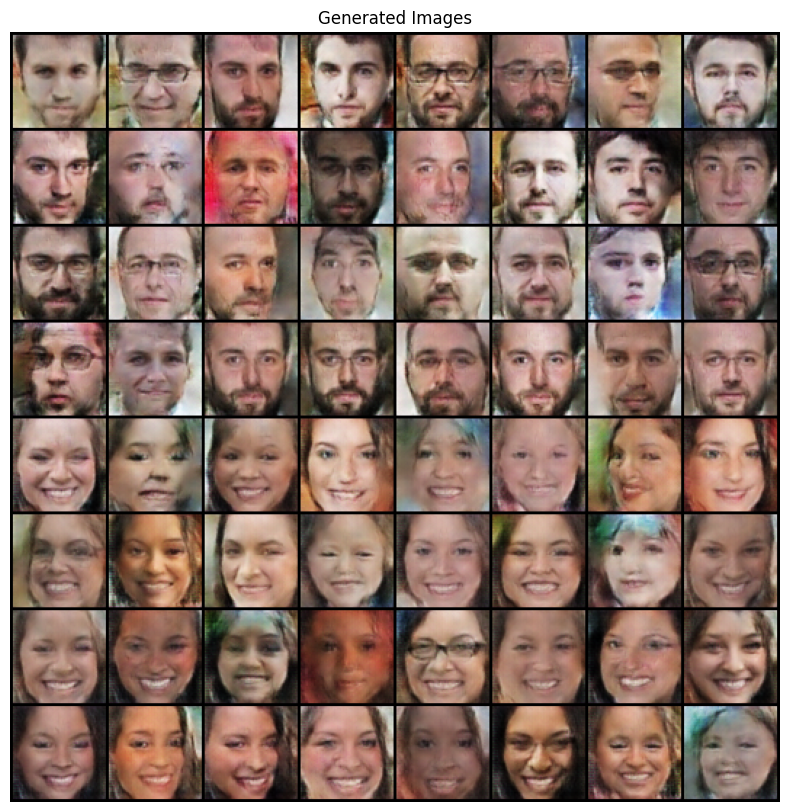

EPOCH: 14.000  g_loss: 4.729  d_loss: 0.449  (960.14s - 754.39s remaining)


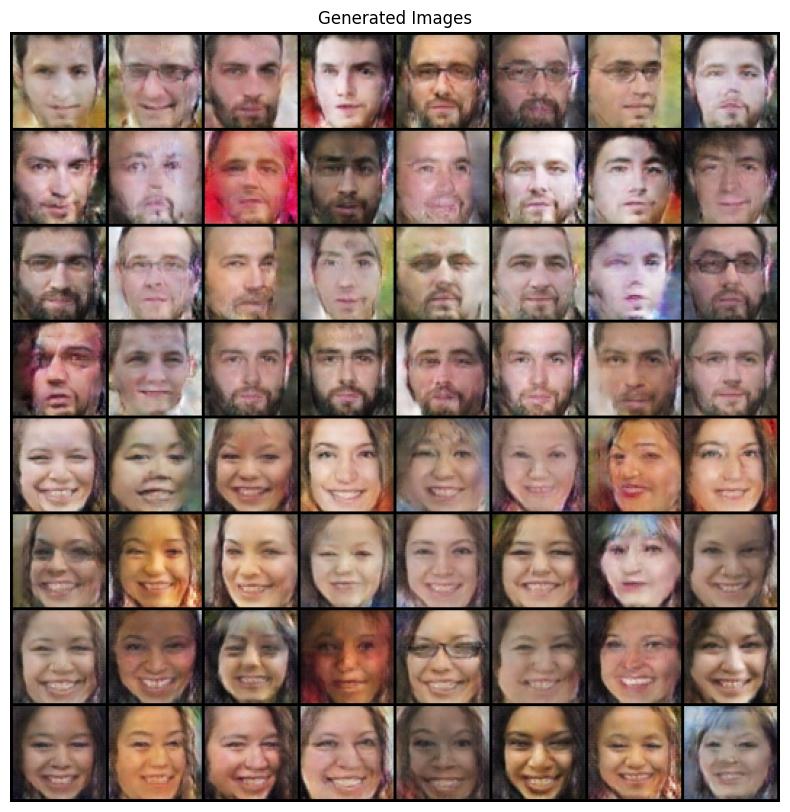

EPOCH: 15.000  g_loss: 4.563  d_loss: 0.428  (1032.54s - 688.36s remaining)


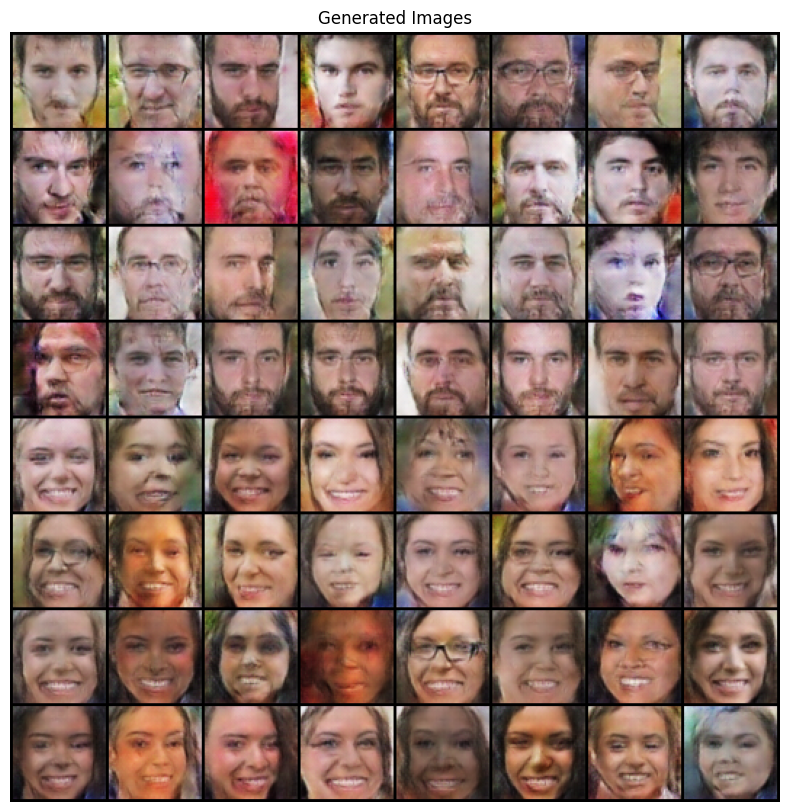

EPOCH: 16.000  g_loss: 4.699  d_loss: 0.437  (1103.42s - 620.67s remaining)


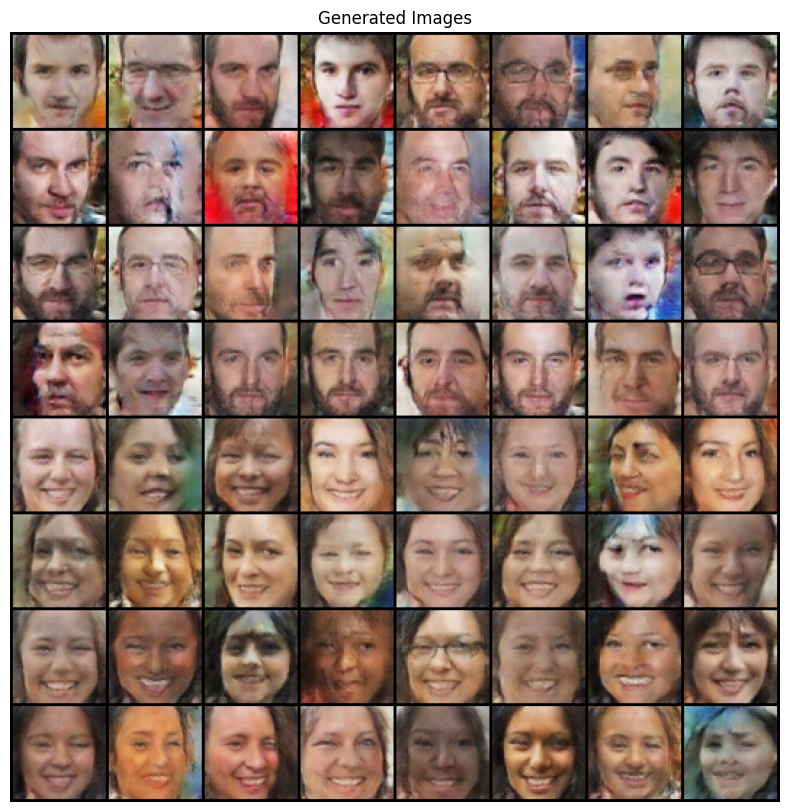

EPOCH: 17.000  g_loss: 4.582  d_loss: 0.421  (1175.16s - 553.02s remaining)


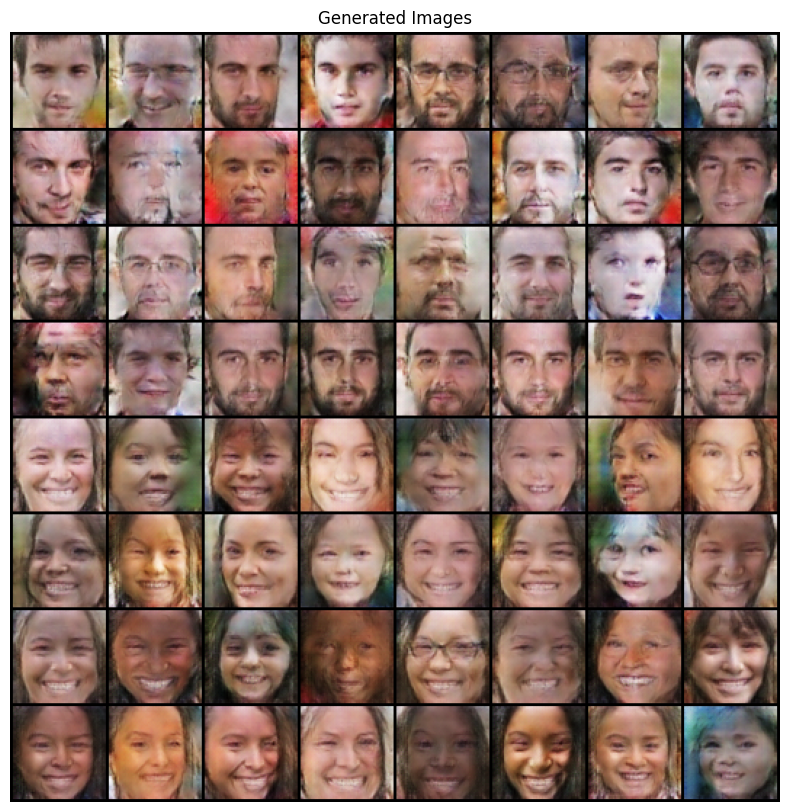

EPOCH: 18.000  g_loss: 4.590  d_loss: 0.419  (1245.98s - 484.55s remaining)


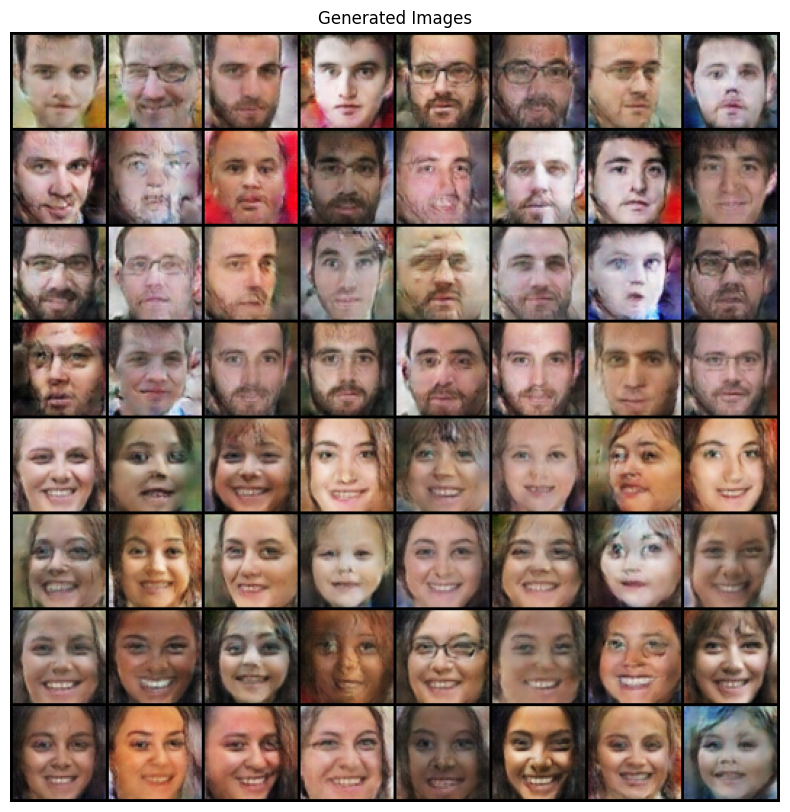

EPOCH: 19.000  g_loss: 4.598  d_loss: 0.390  (1316.71s - 415.80s remaining)


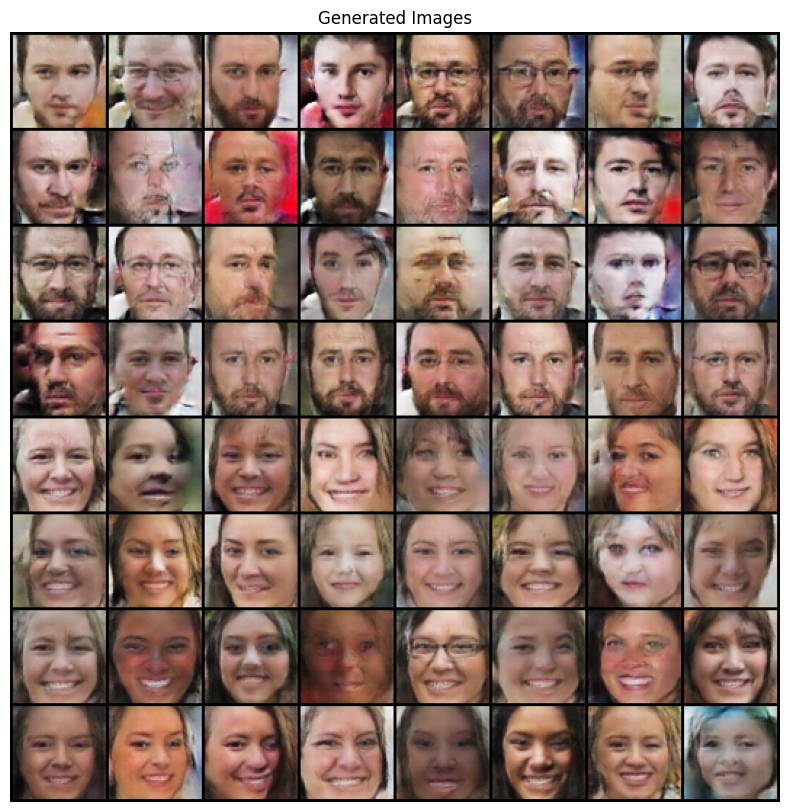

EPOCH: 20.000  g_loss: 4.509  d_loss: 0.441  (1387.78s - 346.95s remaining)


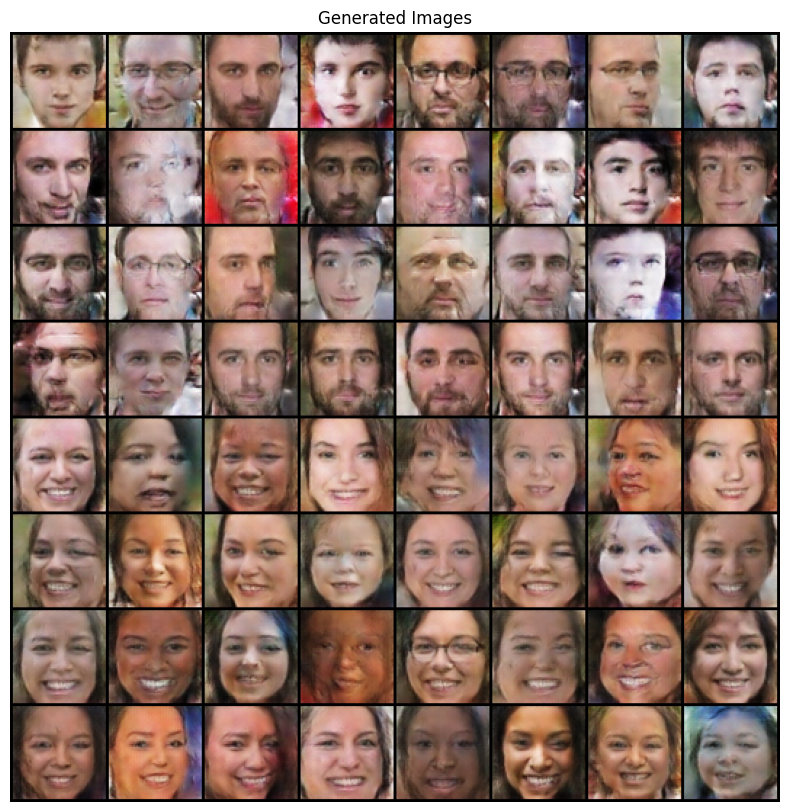

EPOCH: 21.000  g_loss: 4.759  d_loss: 0.365  (1460.46s - 278.18s remaining)


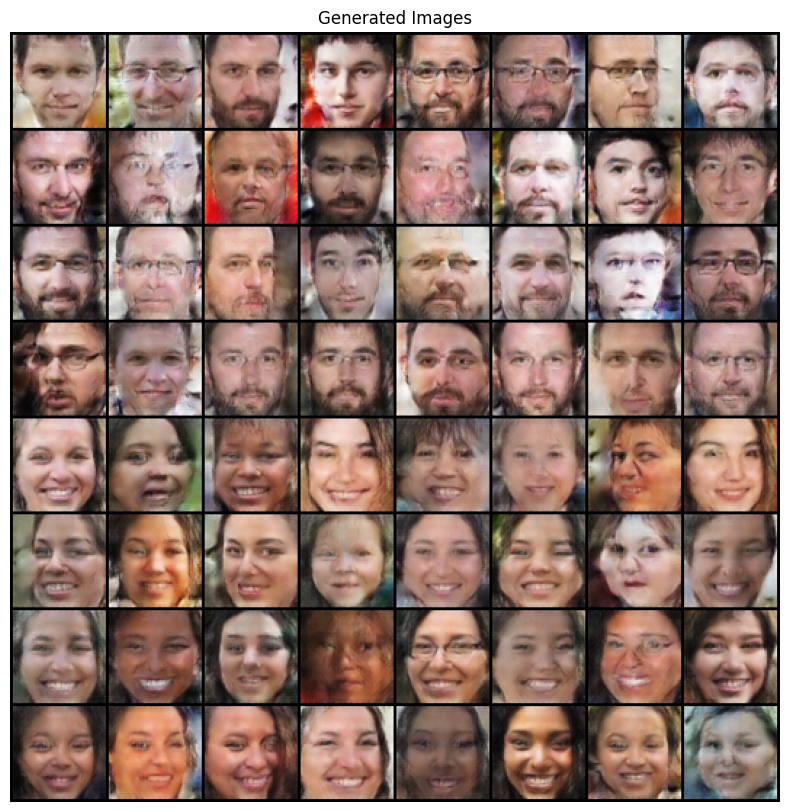

EPOCH: 22.000  g_loss: 4.387  d_loss: 0.409  (1533.25s - 209.08s remaining)


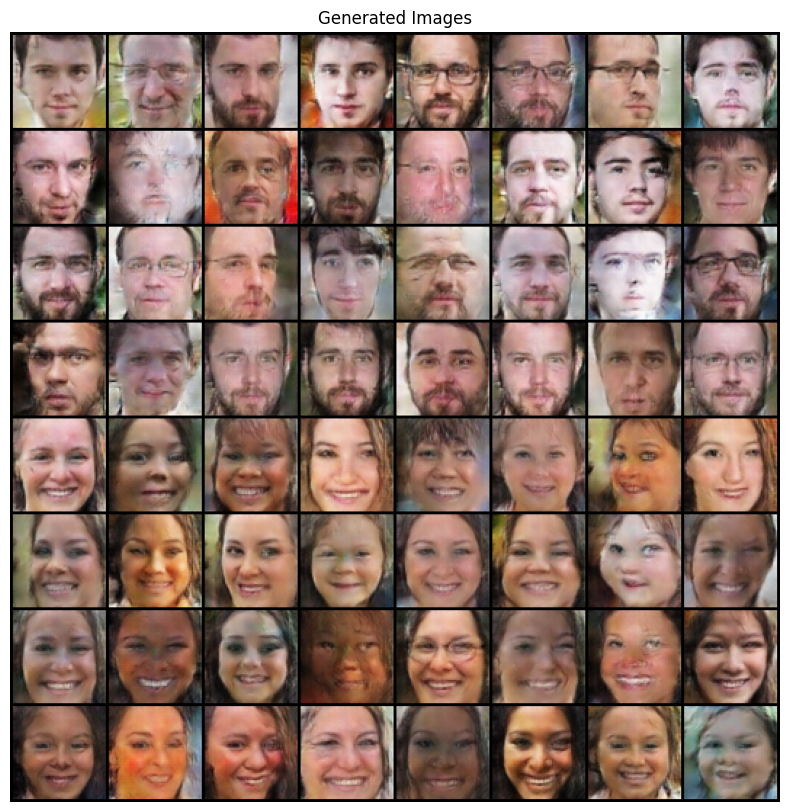

EPOCH: 23.000  g_loss: 4.800  d_loss: 0.330  (1604.47s - 139.52s remaining)


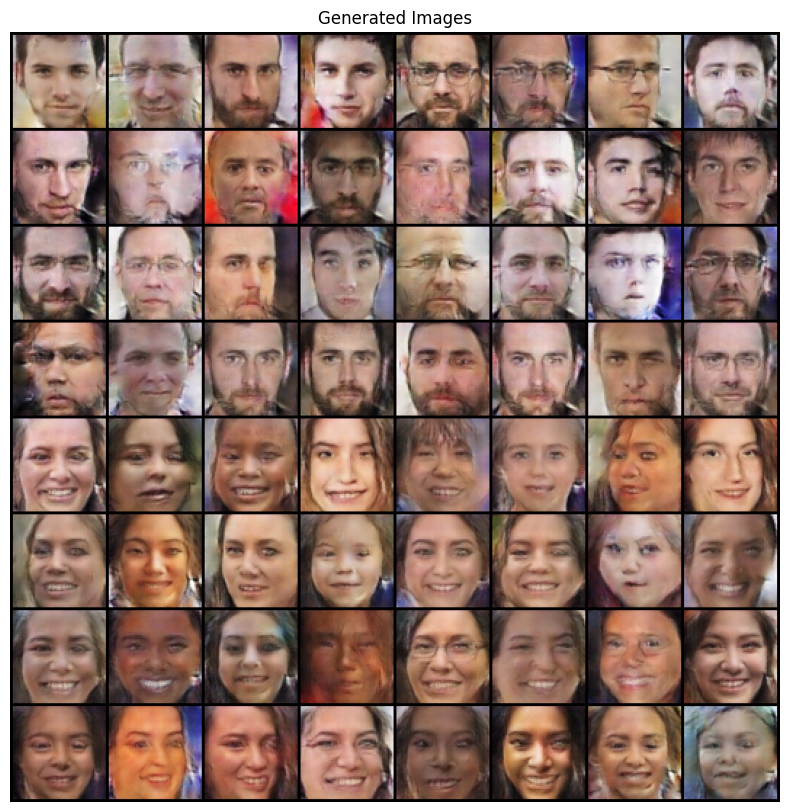

EPOCH: 24.000  g_loss: 4.513  d_loss: 0.438  (1675.30s - 69.80s remaining)


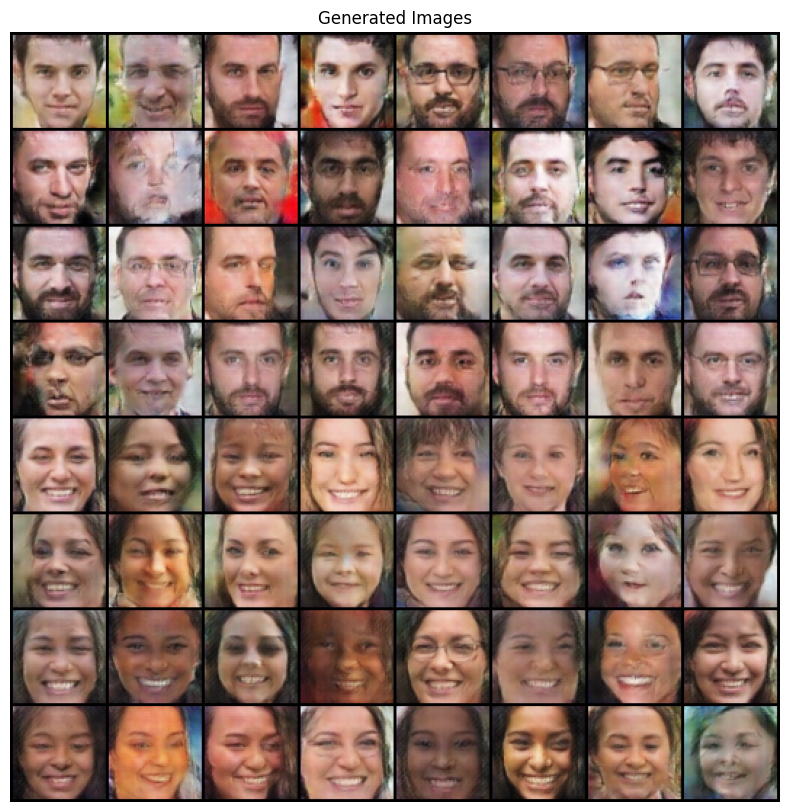

EPOCH: 25.000  g_loss: 4.275  d_loss: 0.451  (1747.01s - 0.00s remaining)


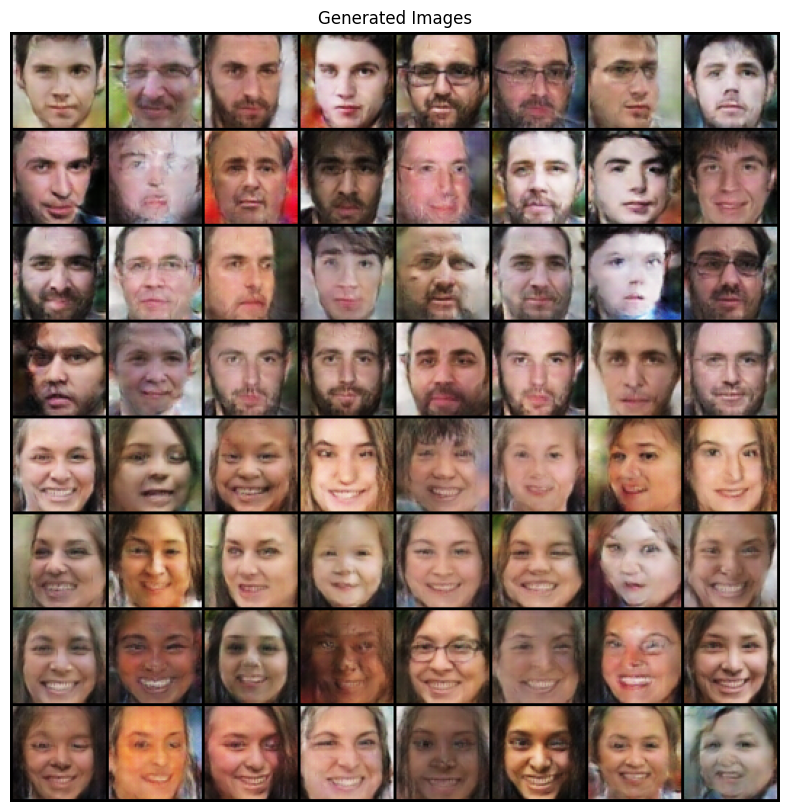

100%|██████████| 126/126 [00:01<00:00, 98.14it/s] 


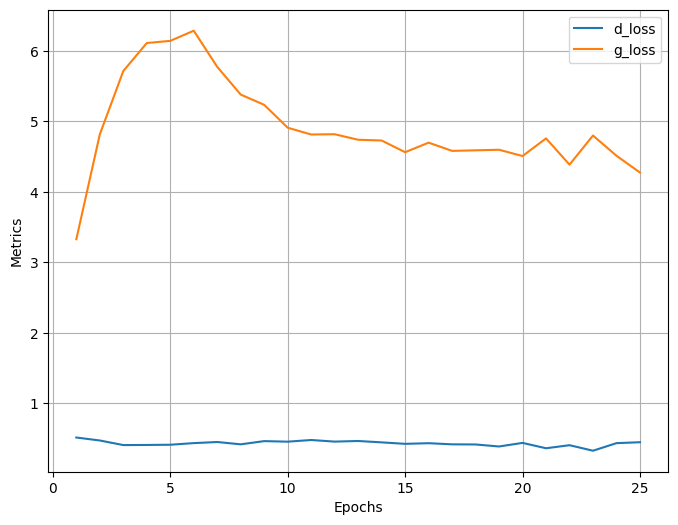

In [16]:
# Train the model
discriminator = Discriminator().to(device)
generator = Generator().to(device)
criterion = nn.BCELoss()
d_optimizer = optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
fixed_noise = noise(64) # 64 random noise vectors
fixed_fake_labels = torch.LongTensor([0]*(len(fixed_noise)//2) + [1]*(len(fixed_noise)//2)).to(device) # 1/2 Male, 1/2 Female fake labels
dataloader = load_data()
n_epochs = 25
log = Report(n_epochs)

for epoch in range(n_epochs):
    n = len(dataloader)
    for i, (images, labels) in enumerate(dataloader):
        # Train the Discriminator
        real_data, real_labels = images.to(device), labels.to(device)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels).to(device)
        fake_data = fake_data.detach() # detach tensor so training discriminator does not affect generator
        d_loss = train_discriminator(discriminator, (real_data, real_labels, fake_data, fake_labels), criterion, d_optimizer)

        # Train the Generator
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device) # regenerate fake labels
        fake_data = generator(noise(len(real_data)), fake_labels).to(device) # regenerate fake data
        g_loss = train_generator(discriminator, (fake_data, fake_labels), criterion, g_optimizer)
        log.record(epoch+(i+1)/n, d_loss=d_loss.item(), g_loss=g_loss.item(), end='\r')

    # Log the average loss for the epoch
    log.report_avgs(epoch+1)

    # Plot the generated images
    with torch.no_grad():
        generated_images = generator(fixed_noise, fixed_fake_labels).detach().cpu()
        grid = make_grid(generated_images, padding=2, normalize=True)
        show(grid.cpu().detach().permute(1, 2, 0), sz=10, title='Generated Images')

# Plot the loss
log.plot_epochs(['d_loss', 'g_loss'])